# Import

In [1]:
import json
import itertools

import matplotlib.pyplot as plt
from matplotlib.cm import ScalarMappable
from matplotlib.colors import Normalize
import pandas as pd
import seaborn as sns

from matplotlib import rcParams
rcParams['figure.figsize'] = 8, 8

# Function declaration

In [2]:
def save_fig(fig, name):
    fig.savefig("./graphs/" + name + ".png", format="png")

In [3]:
def fix_status(df_line):
    if df_line.status != "UNKNOWN":
        return df_line.status

    if df_line.objectives != {}:
        return "SATISFIABLE"

    return df_line.status

In [4]:
def get_optimal_solution(df_line):
    if df_line.status != "OPTIMAL_SOLUTION":
        return None

    return min(df_line.objectives.values())

In [5]:
def over_300(row):
    if row.solve_time > 300:
        row.solve_time = 300
        row.objectives = {k : v for k, v in row.objectives.items() if float(k) < 300}
        row.status = "Satisfiable" if len(row.objectives) > 1 else "Unknown"

    return row

In [6]:
def check(x : pd.DataFrame):
    try:
        model1 = x.iloc[0]
        model2 = x.iloc[1]

        status1 = model1.status
        status2 = model2.status

        obj1 = min(model1.objectives.values(), default=None)
        obj2 = min(model2.objectives.values(), default=None)
    except:
        return pd.DataFrame(x).assign(reason="NO CONFRONTATION")

    if status1 == "Optimal solution":
        if status2 == "Optimal solution":
            if obj1 != obj2:
                return x.assign(reason="BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT")
        elif status2 == "Unsatisfiable":
            return x.assign(reason="ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT")
    elif status1 == "Unsatisfiable":
        if status2 == "Satisfiable" or status2 == "Optimal solution":
            return x.assign(reason="ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT")
    elif status1 == "Satisfiable":
        if status2 == "Unsatisfiable":
            return x.assign(reason="ONE SOLVER SAY SAT BUT THE OTHER ONE SAY UNSAT")

In [7]:
def score(t1, t2):
    if t1 == 0 and t2 == 0:
        return (0.5, 0.5)
    else:
        return (
            t2 / (t1 + t2),
            t1 / (t1 + t2),
        )

def solved(x):
    if (
        x.status == "Optimal solution"
        or
        x.status == "Unsatisfiable"
        or
        x.status == "Satisfiable"
    ):
        return True

    return False

def optimal(x):
    return True if x.status == "Optimal solution" else False

def quality(x):
    return min(x.objectives.values(), default=None)

def better(x0, x1):
    q0 = quality(x0)
    q1 = quality(x0)
    if (
        (solved(x0) and not solved(x1))
        or
        (optimal(x0) and not optimal(x1))
        or
        ((q0 < q1) if q0 is not None and q1 is not None else False)
    ):
        return True

    return False

def borda_count(x):
    x0 = x.iloc[0]
    x1 = x.iloc[1]

    b0 = better(x0, x1)
    b1 = better(x1, x0)

    if b0 and not b1:
        return (1, 0)
    elif (b0 and b1) or (not b0 and not b1):
        return score(int(x0.solve_time), int(x1.solve_time))
    else:
        return (0, 1)


In [8]:
def import_df(path) -> pd.DataFrame:
    with open(path, "r") as f:
        results = json.load(f)

    dfs = []
    for k, v in results.items():
        x = pd.DataFrame(v).assign(**{
            "solver" : k
        })

        # Add test features
        test_feature = pd.DataFrame(
            x.problem.apply(lambda s : s.split("/")[-1][:-4].split("_")).tolist(),
            columns=["components", "flavours", "nodes", "resources", "comps_topology", "infra_topology", "test"]
        ).assign(**{
            "components" : lambda df : df.components.apply(lambda x : int(x[1:])),
            "flavours": 1, # lambda df : df.flavours.apply(lambda x : int(x[1:])),
            "nodes" : lambda df : df.nodes.apply(lambda x : int(x[1:])),
            "resources" : 1, # lambda df : df.resources.apply(lambda x : int(x[1:])),
            "comps_topology" : lambda df : df.comps_topology.apply(lambda x : x[1:].upper()),
            "infra_topology" : lambda df : df.infra_topology.apply(lambda x : x[1:].upper()),
            "test" : lambda df : df.test.apply(lambda x : int(x))
        }).assign(**{
            "model": x.problem.apply(lambda s : s.split("/")[-2].upper()).tolist(),
        })

        dfs.append(
            pd.merge(
                left=x,
                right=test_feature,
                right_index=True,
                left_index=True,
            )
        )

    return (
        pd.concat(dfs)
        .rename(columns={"model_y" : "model"})
        .assign(**{
            # Corrections for unkown status codes
            "solve_time" : lambda df : df.apply(
                lambda x :
                    300
                    if "UNKNOWN" in x["status"]
                    else x.solve_time,
                axis=1),
            "status" : lambda df : df.apply(
                lambda x : fix_status(x),
            axis=1),
        })
        .replace({ # Rename some stuff
            "cpsatlp": "OR-Tools",
            "gecode": "Gecode",
            "highs": "Highs",
            "chuffed": "Chuffed",
            "BARABASI": "small-world",
            "ERDOS": "random",
            "LADDER": "ladder",
            "WHEEL": "wheel",
            "PATH": "pipeline",
            "COMPLETE": "complete",
            "SATISFIABLE": "Satisfiable",
            "OPTIMAL_SOLUTION": "Optimal solution",
            "UNSATISFIABLE": "Unsatisfiable",
            "UNKNOWN": "Unknown",
            "ZEPHYRUS": "Zephyrus"
        })
        .assign(optimal_solution=lambda df : df.apply(
            lambda x : min(x.objectives.values()) if "Optimal solution" in x.status else None, axis=1
        ))
        .drop(columns=["problem"])
        .apply(over_300, axis=1)
        .reset_index(drop=True)
    )

In [9]:
def get_to_rerun_df(df, combinations):
    # Get instances were status is discordant or it is not run by all solvers
    indexes = set(df.set_index(["components", "nodes", "comps_topology", "test", "model", "solver"]).index)

    to_rerun = pd.DataFrame(
        data=combinations - indexes,
        columns=["components", "nodes", "comps_topology", "test", "model", "solver"]
    )
    to_rerun.drop_duplicates()

    check = (
        df
        .reset_index()
        .rename(columns={"index": "drop_index"})
        .drop(columns=["flavours", "resources", "flat_time", "solve_time", "infra_topology", "objectives"])
        .groupby(["components", "nodes", "comps_topology", "test"])
    )

    status_discordant = []
    not_all_solvers = []
    for _, group in check:
        if len(group) != 6: # 6 = 3 solvers x 2 models
            not_all_solvers.append(group)
            continue

        a = group.status.value_counts().reset_index()
        if len(a.query("status == 'Unsatisfiable'")) > 0 and len(a.query("status != 'Unsatisfiable'")) > 0:
                status_discordant.append(group)

    to_rerun = pd.concat([
        to_rerun,
        pd.concat(not_all_solvers).drop_duplicates() if len(not_all_solvers) > 0 else pd.DataFrame()
    ], axis=1)

    to_rerun = pd.concat([
        to_rerun,
        pd.concat(status_discordant).drop_duplicates() if len(status_discordant) > 0 else pd.DataFrame()
    ], axis=1)

    return to_rerun

# DataFrame import

In [10]:
component_topologies = ['small-world', 'random', 'pipeline']
solvers = ['Chuffed', 'Highs', 'OR-Tools']
models = ['FREEDA', 'Zephyrus']

In [11]:
combinations = set(itertools.product(
    range(4, 32 + 1), #components
    range(3, 32 + 1), #nodes
    component_topologies,
    range(0, 3), #tests
    models,
    solvers
))
len(combinations)

46980

In [12]:
color = {
    "Chuffed" : "red",
    "OR-Tools": "orange",
    "Gecode" : "#1f77b4",
    "Highs" : "green"
}

marker = {
    "Chuffed" : ".",
    "OR-Tools": "+",
    "Gecode" : "x",
    "Highs" : "2"
}

marker_model = {
    "FREEDA": "*",
    "Zephyrus": "x"
}

color_model = {
    "FREEDA": "#1f77b4",
    "Zephyrus": "red"
}

In [13]:
main_df = (
    import_df("results/freeda-vs-zephyrus-32x32x3.json")
    .query("infra_topology == 'complete'")
    .query("components <= 32")
    .query("nodes <= 32")
)
main_df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
0,Optimal solution,0.550,0.574,{'0.574': 0},Chuffed,4,1,3,1,small-world,complete,0,FREEDA,0.0
1,Optimal solution,0.519,0.544,{'0.544': 3},Chuffed,4,1,3,1,small-world,complete,1,FREEDA,3.0
2,Optimal solution,0.507,0.539,"{'0.538': 8, '0.539': 1}",Chuffed,4,1,3,1,small-world,complete,2,FREEDA,1.0
3,Optimal solution,0.150,0.171,"{'0.17': 11, '0.171': 2}",Chuffed,4,1,3,1,small-world,complete,0,Zephyrus,2.0
4,Optimal solution,0.153,0.173,"{'0.172': 18, '0.173': 3}",Chuffed,4,1,3,1,small-world,complete,1,Zephyrus,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46939,Optimal solution,1.024,1.579,"{'1.29': 4, '1.399': 3, '1.472': 1}",OR-Tools,32,1,32,1,pipeline,complete,1,FREEDA,1.0
46940,Optimal solution,1.023,1.824,"{'1.295': 8, '1.407': 6, '1.507': 5, '1.607': ...",OR-Tools,32,1,32,1,pipeline,complete,2,FREEDA,1.0
46941,Optimal solution,21.428,46.958,"{'30.035': 6, '32.847': 5, '35.681': 4, '38.50...",OR-Tools,32,1,32,1,pipeline,complete,0,Zephyrus,1.0
46942,Optimal solution,21.559,44.398,"{'30.068': 6, '32.884': 5, '35.694': 4, '38.5'...",OR-Tools,32,1,32,1,pipeline,complete,1,Zephyrus,1.0


In [14]:
to_rerun = get_to_rerun_df(main_df, combinations)
to_rerun

,components,nodes,comps_topology,test,model,solver
0,10,13,random,0,Zephyrus,OR-Tools
1,10,13,random,0,FREEDA,Highs
2,10,13,random,1,Zephyrus,OR-Tools
3,9,22,small-world,1,Zephyrus,Highs
4,9,22,small-world,2,FREEDA,OR-Tools
5,9,22,small-world,0,Zephyrus,Chuffed
6,9,22,small-world,2,Zephyrus,Highs
7,9,22,small-world,1,FREEDA,Chuffed
8,10,13,random,1,FREEDA,Highs
9,9,22,small-world,0,FREEDA,OR-Tools


In [15]:
# Istances where solvers are bugged
df_model_solver = main_df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["flavours", "resources", "flat_time", "infra_topology"])

models_solvers = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

errors = []
for model_solver1, model_solver2 in models_solvers:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        a = check(group)
        if a is not None:
            errors.append(a)

In [16]:
error_optimal_obj_discordant = (
    pd.concat(errors)
    .drop(columns=["objectives"])
    .drop_duplicates()
    .query("reason == 'BOTH SOLVERS SAY THEY REACHED OPTIMAL SOLUTION BUT THE VALUES ARE DIFFERENT'")
    .groupby(["components", "nodes", "comps_topology", "test"])
)

for _, g in error_optimal_obj_discordant:
    optimals = g.groupby("model").aggregate({"optimal_solution": set})
    freeda_optimals = optimals.loc["FREEDA"]["optimal_solution"]
    zephyrus_optimals = optimals.loc["Zephyrus"]["optimal_solution"]
    if len(freeda_optimals) != 1:
        print("MORE SOLUTIONS IN FREEDA")
    if len(zephyrus_optimals) != 1:
        print("MORE SOLUTIONS IN ZEPHYRUS")

    values = g[["solver", "model", "optimal_solution"]].set_index(["solver", "model"]).unstack().nunique().sum()

    if values > 2:
        print("SOME MODEL-SOLVER COMBINATION PRESENT MORE THAN A SOLUTION")


In [17]:
instances = len(set(itertools.product(
    range(4, 32 + 1), #components
    range(3, 32 + 1), #nodes
    component_topologies,
    range(0, 3), #tests
)))

instances - len(error_optimal_obj_discordant.count()) == instances

False

In [18]:
to_rerun = pd.concat([
    to_rerun,
    (
        pd.concat(errors)
        [["components", "nodes", "comps_topology", "test", "model", "solver"]]
        .drop_duplicates()
    ) if len(errors) > 0 else pd.DataFrame()
]).drop_duplicates()
to_rerun

,components,nodes,comps_topology,test,model,solver
0,10,13,random,0,Zephyrus,OR-Tools
1,10,13,random,0,FREEDA,Highs
2,10,13,random,1,Zephyrus,OR-Tools
3,9,22,small-world,1,Zephyrus,Highs
4,9,22,small-world,2,FREEDA,OR-Tools
...,...,...,...,...,...,...
32701,6,21,small-world,1,FREEDA,OR-Tools
32911,6,32,pipeline,1,FREEDA,OR-Tools
33217,7,19,pipeline,1,FREEDA,OR-Tools
34970,10,27,pipeline,2,FREEDA,OR-Tools


In [19]:
# with open("rerun.txt", "w") as f:
#     f.write(
#         to_rerun
#         .replace({
#             "small-world" : "barabasi_albert",
#             "random" : "erdos_renyi",
#             "pipeline" : "path",
#         })
#         .apply(lambda x:
#             "3 -c "
#             + str(x.components)
#             + " -n "
#             + str(x.nodes)
#             + " -g "
#             + x.comps_topology
#             + " -i complete -o /public/simone.gazza/data/"
#             + f"c{str(x.components)}_n{str(x.nodes)}_g{x.comps_topology.split('_')[0]}_icomplete",
#             axis=1
#         )
#         .drop_duplicates()
#         .str.cat(sep="\n")
#     )

In [20]:
rerun_df = import_df("results/rerun.json").query("solver != 'Gecode'")

In [21]:
rerun_df

,status,flat_time,solve_time,objectives,solver,components,flavours,nodes,resources,comps_topology,infra_topology,test,model,optimal_solution
222,Optimal solution,0.750,0.849,"{'0.825': 13, '0.828': 12, '0.832': 11, '0.835...",Chuffed,9,1,22,1,small-world,complete,0,FREEDA,1.0
223,Optimal solution,0.682,0.772,"{'0.751': 31, '0.754': 22, '0.758': 13, '0.761...",Chuffed,9,1,22,1,small-world,complete,1,FREEDA,1.0
224,Optimal solution,0.711,0.799,"{'0.78': 14, '0.782': 13, '0.785': 10, '0.788'...",Chuffed,9,1,22,1,small-world,complete,2,FREEDA,1.0
225,Optimal solution,0.389,0.612,"{'0.457': 43, '0.462': 41, '0.468': 36, '0.474...",Chuffed,9,1,22,1,small-world,complete,0,Zephyrus,1.0
226,Optimal solution,0.394,0.554,"{'0.461': 27, '0.467': 24, '0.472': 21, '0.477...",Chuffed,9,1,22,1,small-world,complete,1,Zephyrus,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
883,Optimal solution,0.751,0.848,{'0.842': 1},Highs,11,1,24,1,random,complete,1,FREEDA,1.0
884,Optimal solution,0.767,0.873,{'0.867': 1},Highs,11,1,24,1,random,complete,2,FREEDA,1.0
885,Optimal solution,2.405,2.639,"{'2.587': 6, '2.629': 2}",Highs,11,1,24,1,random,complete,0,Zephyrus,2.0
886,Optimal solution,2.384,2.593,"{'2.563': 2, '2.583': 1}",Highs,11,1,24,1,random,complete,1,Zephyrus,1.0


In [22]:
df_grouped = main_df.set_index(["components", "nodes", "comps_topology", "test"])
run_again_grouped = rerun_df.set_index(["components", "nodes", "comps_topology", "test"])
df = pd.concat([
    df_grouped[~df_grouped.index.isin(run_again_grouped.index)],
    run_again_grouped
]).reset_index()

In [23]:
df.solver.unique()

array(['Chuffed', 'Highs', 'OR-Tools'], dtype=object)

In [24]:
len(combinations)

46980

In [25]:
len(combinations) - len(df.drop(columns=["objectives"]).drop_duplicates())

0

In [26]:
# Istances where solvers are bugged
df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["flavours", "resources", "flat_time", "infra_topology"])

models_solvers = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

errors = []
for model_solver1, model_solver2 in models_solvers:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        a = check(group)
        if a is not None:
            errors.append(a)

In [27]:
len(errors)

0

# Clean up

In [28]:
df.groupby(["components", "nodes", "comps_topology", "test"]).count()

status  flat_time  solve_time  \
components nodes comps_topology test                                  
4          3     pipeline       0          6          6           6   
                                1          6          6           6   
                                2          6          6           6   
                 random         0          6          6           6   
                                1          6          6           6   
...                                      ...        ...         ...   
32         32    random         1          6          6           6   
                                2          6          6           6   
                 small-world    0          6          6           6   
                                1          6          6           6   
                                2          6          6           6   

                                      objectives  solver  flavours  resources  \
components nodes comps_topology test                                            
4          3     pipeline       0              6       6         6          6   
                                1              6       6         6          6   
                                2              6       6         6          6   
                 random         0              6       6         6          6   
                                1              6       6         6          6   
...                                          ...     ...       ...        ...   
32         32    random         1              6       6         6          6   
                                2              6       6         6          6   
                 small-world    0              6       6         6          6   
                                1              6       6         6          6   
                                2              6       6         6          6   

                                      infra_topology  model  optimal_solution  
components nodes comps_topology test                                           
4          3     pipeline       0                  6      6                 6  
                                1                  6      6                 6  
                                2                  6      6                 6  
                 random         0                  6      6                 6  
                                1                  6      6                 6  
...                                              ...    ...               ...  
32         32    random         1                  6      6                 4  
                                2                  6      6                 4  
                 small-world    0                  6      6                 4  
                                1                  6      6                 4  
                                2                  6      6                 5  

[7830 rows x 10 columns]

In [29]:
df.query("solve_time > 300")

,components,nodes,comps_topology,test,status,flat_time,solve_time,objectives,solver,flavours,resources,infra_topology,model,optimal_solution


# DataFrame Analysis

In [30]:
df.status.unique()

array(['Optimal solution', 'Satisfiable', 'Unknown'], dtype=object)

In [31]:
df.status.value_counts(normalize=True)

status
Optimal solution    0.986994
Unknown             0.010324
Satisfiable         0.002682
Name: proportion, dtype: float64

In [32]:
df[["components", "status"]].groupby("components").value_counts()

components  status          
4           Optimal solution    1620
5           Optimal solution    1620
6           Optimal solution    1620
7           Optimal solution    1620
8           Optimal solution    1620
9           Optimal solution    1620
10          Optimal solution    1620
11          Optimal solution    1620
12          Optimal solution    1620
13          Optimal solution    1620
14          Optimal solution    1620
15          Optimal solution    1620
16          Optimal solution    1620
17          Optimal solution    1620
18          Optimal solution    1619
            Satisfiable            1
19          Optimal solution    1620
20          Optimal solution    1618
            Unknown                2
21          Optimal solution    1620
22          Optimal solution    1619
            Unknown                1
23          Optimal solution    1611
            Unknown                8
            Satisfiable            1
24          Optimal solution    1617
         

In [33]:
df[["nodes", "status"]].groupby("nodes").value_counts()

nodes  status          
3      Optimal solution    1550
       Unknown               15
       Satisfiable            1
4      Optimal solution    1553
       Unknown               13
                           ... 
31     Unknown               21
       Satisfiable            2
32     Optimal solution    1534
       Unknown               27
       Satisfiable            5
Name: count, Length: 89, dtype: int64

In [34]:
pd.concat(
    [
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(),
        df[["components", "nodes", "status"]].groupby(["components", "nodes"]).value_counts(normalize=True) * 100
    ],
    axis=1,
    keys=['counts', '%']
).reset_index()#.to_csv("./status_aggregated.csv", index=False)

,components,nodes,status,counts,%
0,4,3,Optimal solution,54,100.000000
1,4,4,Optimal solution,54,100.000000
2,4,5,Optimal solution,54,100.000000
3,4,6,Optimal solution,54,100.000000
4,4,7,Optimal solution,54,100.000000
...,...,...,...,...,...
1135,32,31,Unknown,7,12.962963
1136,32,31,Satisfiable,1,1.851852
1137,32,32,Optimal solution,44,81.481481
1138,32,32,Unknown,7,12.962963


<Axes: title={'center': 'Distribution of solve_time'}>

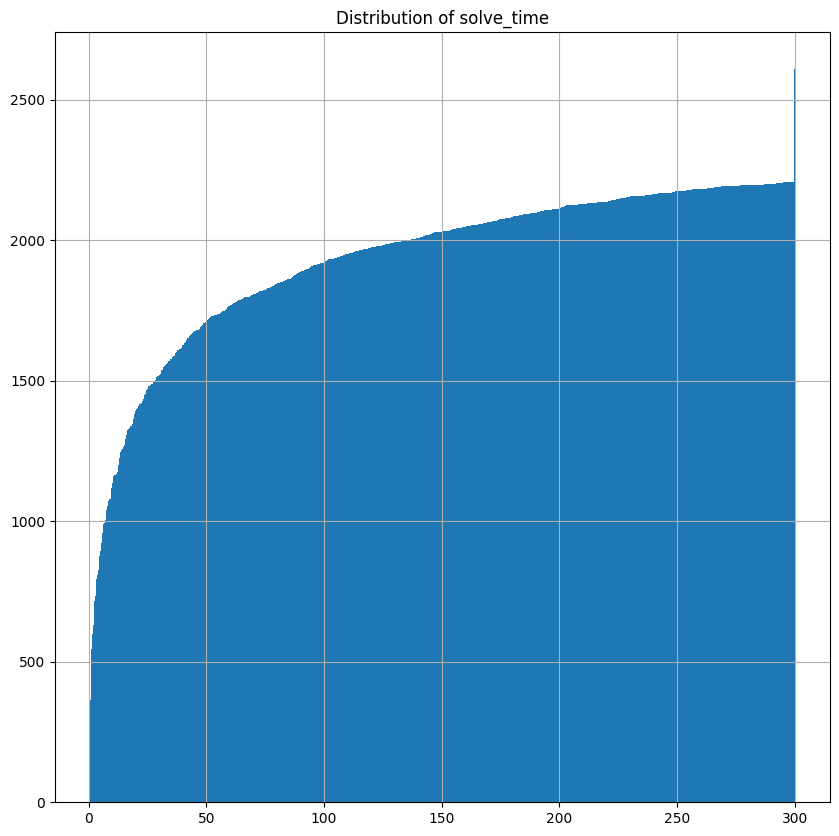

In [35]:
plt.figure(figsize=(10, 10))
plt.title("Distribution of solve_time")
vbs = df.sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

<Axes: title={'center': 'Distribution only for Optimal solutions'}>

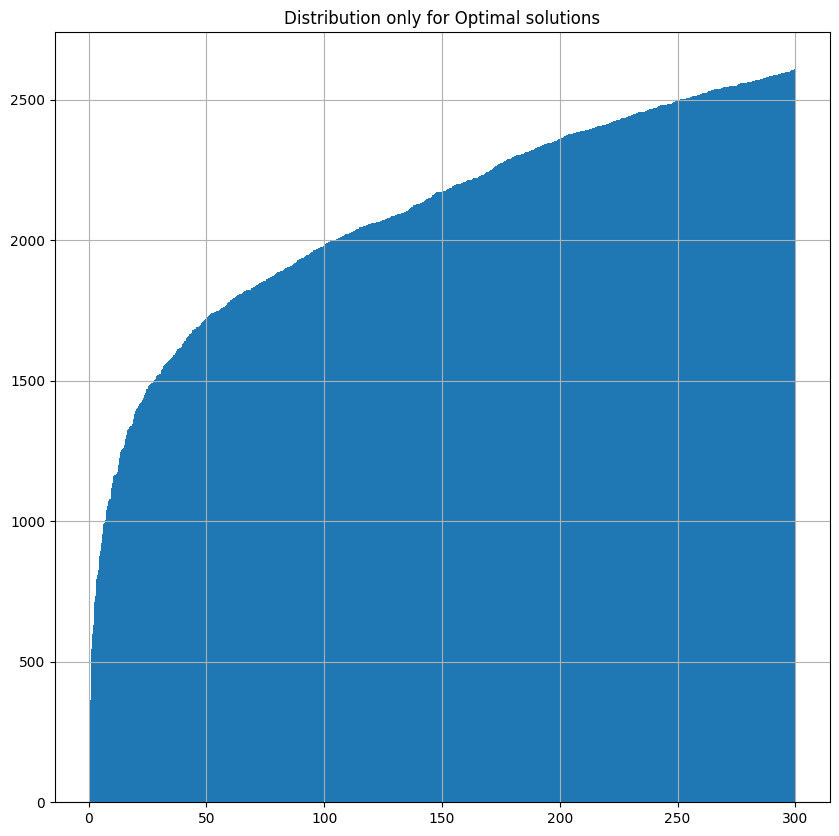

In [36]:
plt.figure(figsize=(10, 10))
plt.title("Distribution only for Optimal solutions")
vbs = df.query("status == 'Optimal solution'").sort_values("solve_time", ascending=False).groupby(["components", "nodes", "test"]).head(1)
vbs.solve_time.sort_values().hist(bins=1000, cumulative=True)

# Solve Time

### Components

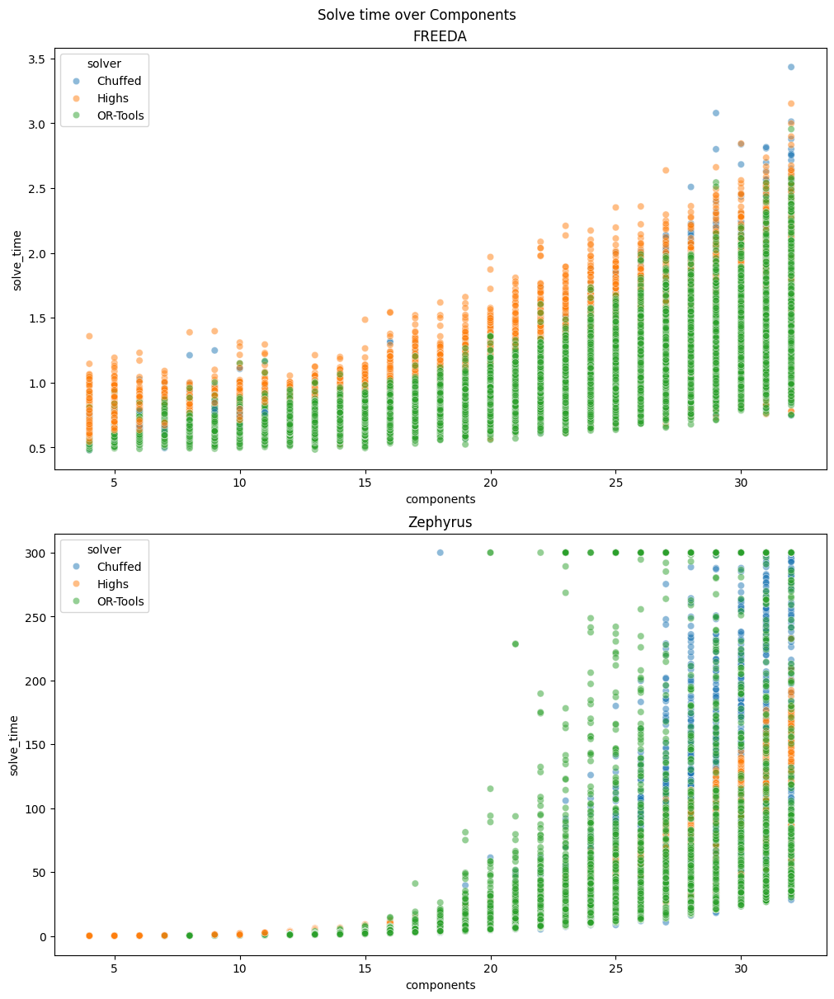

In [37]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

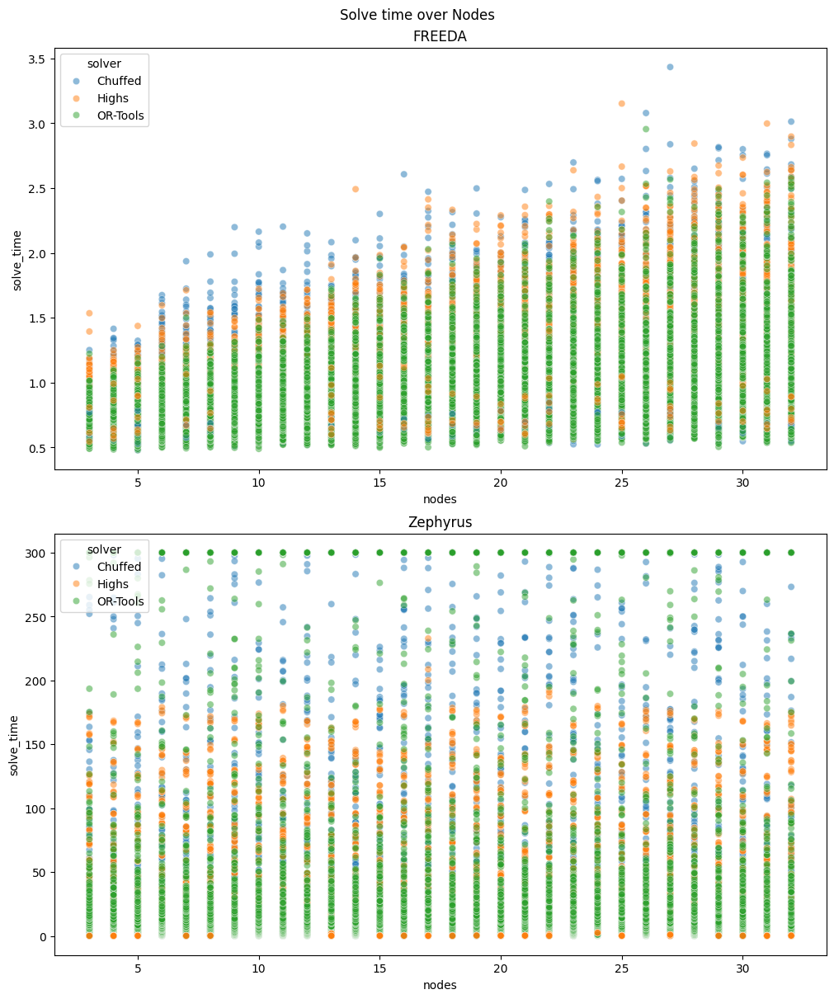

In [38]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Solve time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(str(m))
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="solve_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

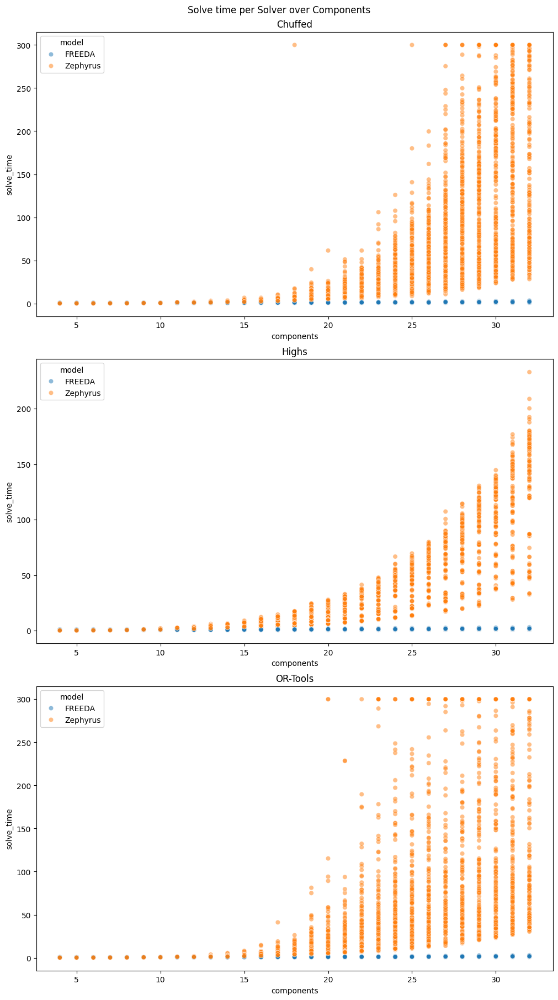

In [39]:
fig, axs = plt.subplots(len(solvers), 1, constrained_layout=True)
fig.suptitle("Solve time per Solver over Components")
fig.set_figheight(6 * len(solvers))
fig.set_figwidth(10)
for s, ax in zip(solvers, axs):
    ax.set_title(str(s))
    sns.scatterplot(
        data=df.query("solver == @s"),
        x="components",
        y="solve_time",
        alpha=0.5,
        hue="model",
        ax=ax
    )

### Components x nodes

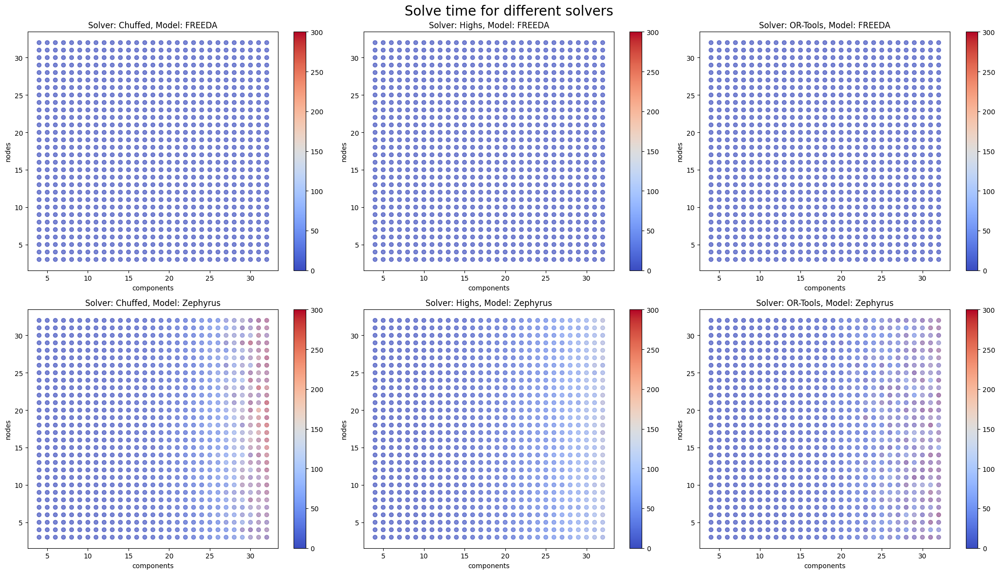

In [40]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(7 * len(solvers), 6 * len(models))
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)
        fig.colorbar(ScalarMappable(norm=norm, cmap="coolwarm"), ax=ax, orientation='vertical')

fig.suptitle("Solve time for different solvers", fontsize=20)
fig.tight_layout()

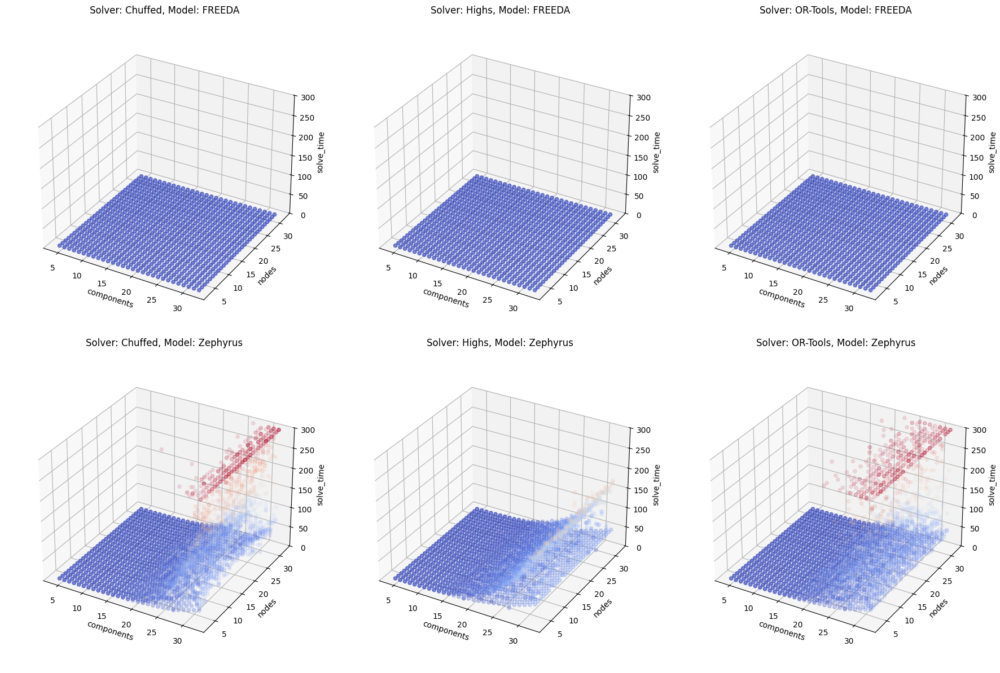

In [41]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.solve_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.solve_time,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_zlabel("solve_time")
        ax.set_title("Solver: " + s + ", Model: " + m)
        ax.set_box_aspect(None, zoom=0.90)
        ax.set_zlim([0, 300])

fig.tight_layout()

### Topologies

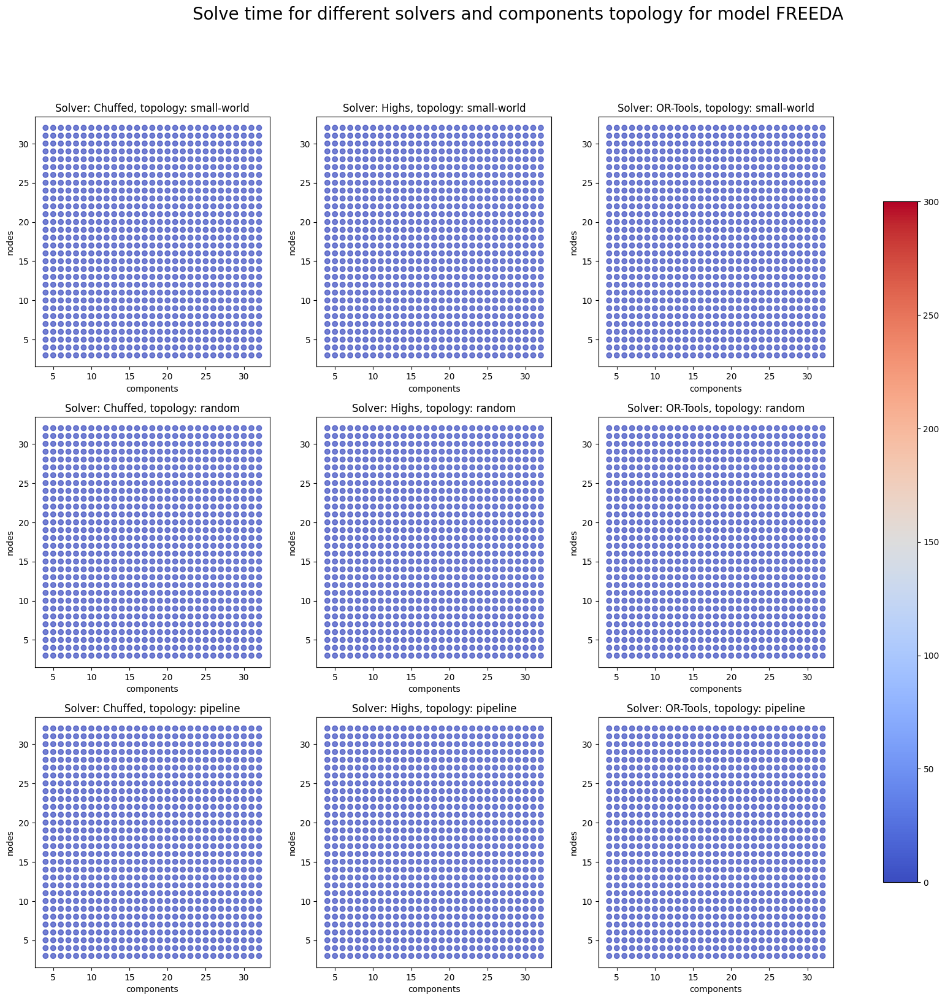

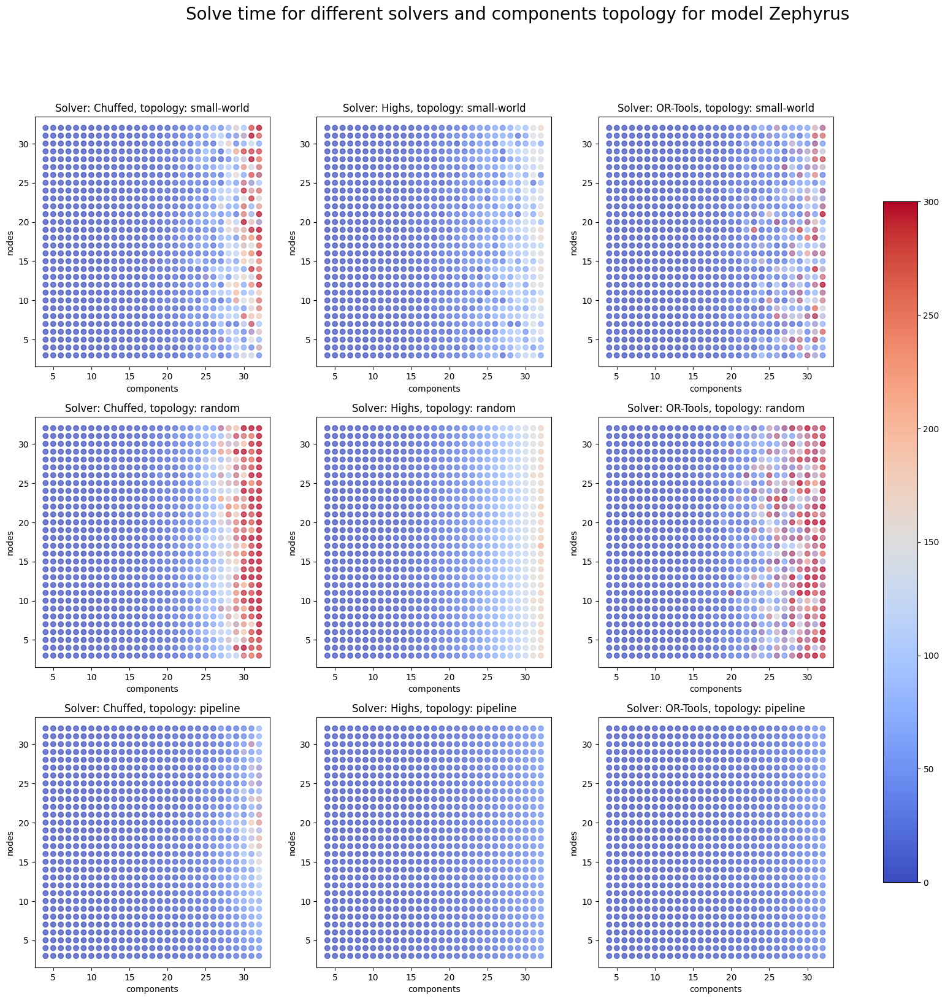

In [42]:
norm = Normalize(vmin=0, vmax=300)
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_model = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_model.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/3
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Solve time for different solvers and components topology for model " + m, fontsize=20)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

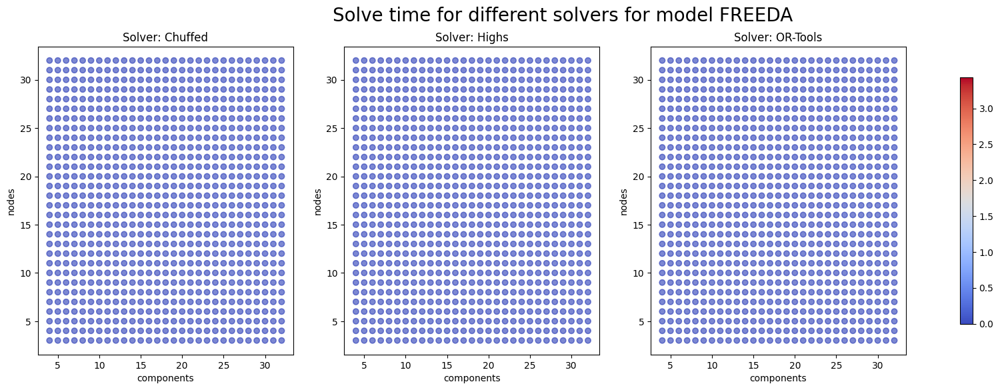

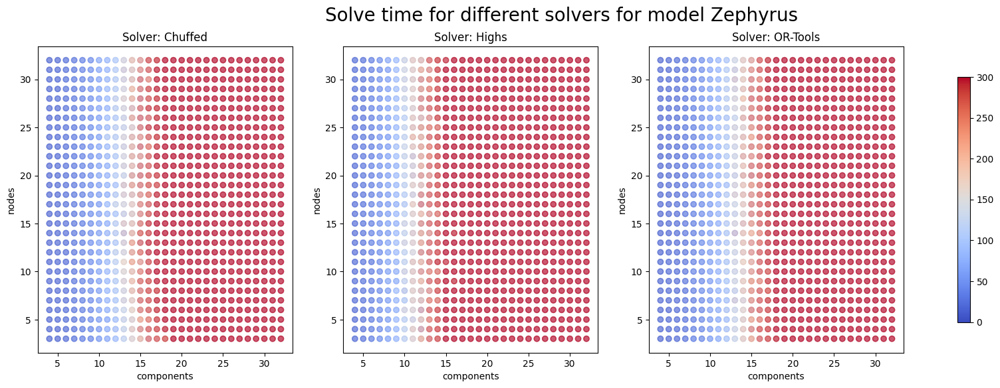

In [43]:
for m in models:
    fig, axs = plt.subplots(
        nrows=1,
        ncols=len(solvers),
        figsize=(7 * len(solvers), 6)
    )
    axs_reshaped = axs.reshape(-1)
    df_model = df.query("model == @m")
    for solver, ax in zip(solvers, axs_reshaped):
        d = df_model.query("solver == @solver")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.solve_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver)

    norm = Normalize(vmin=0, vmax=df_model.solve_time.max())
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )
    fig.suptitle("Solve time for different solvers for model " + m, fontsize=20)

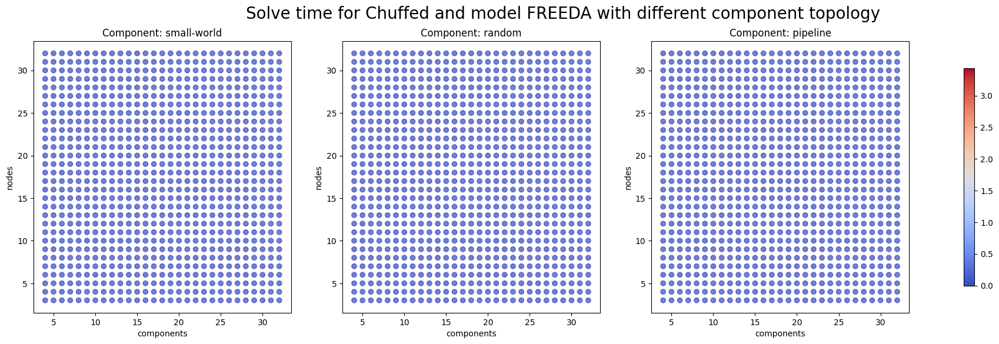

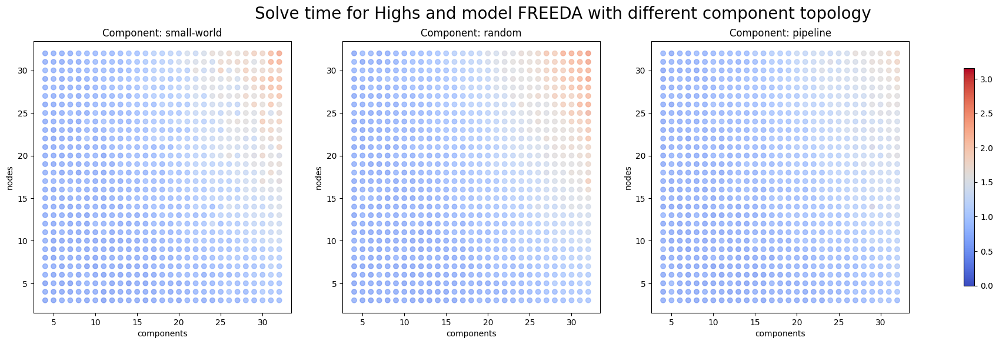

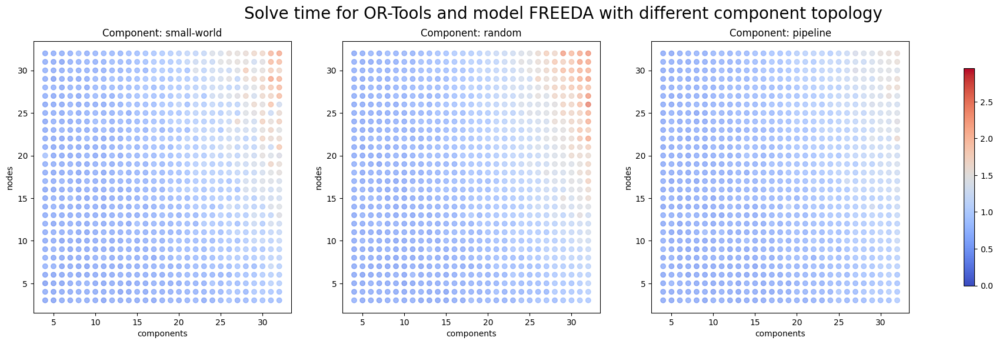

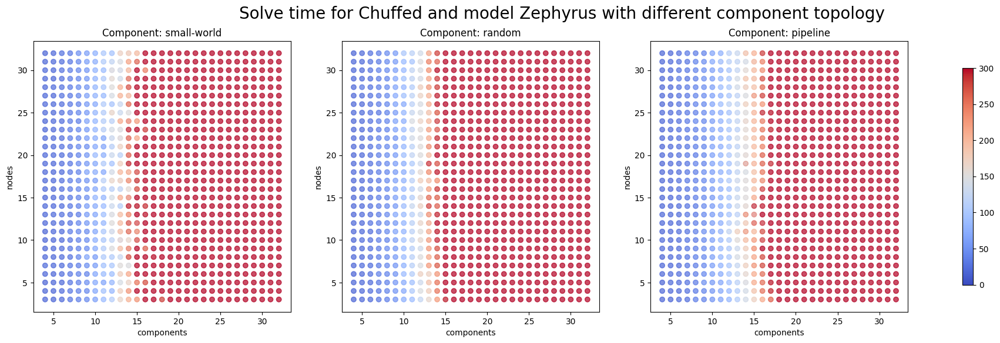

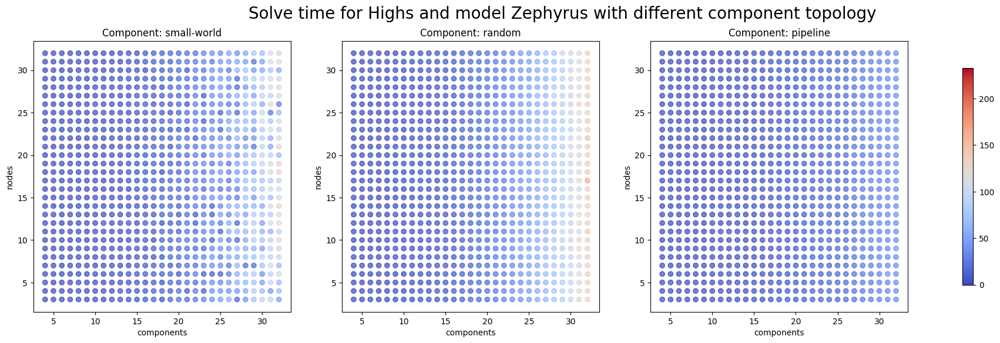

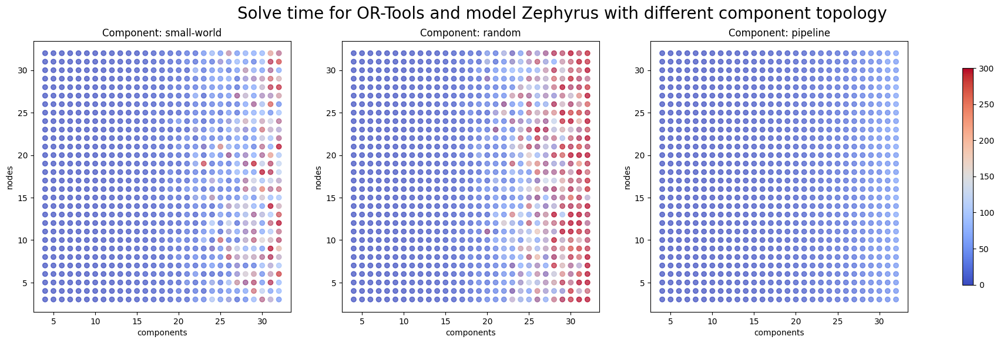

In [44]:
for m in models:
    for solver in solvers:
        fig, axs = plt.subplots(
            nrows=1,
            ncols=len(component_topologies),
            figsize=(8 * len(component_topologies), 6)
        )
        axs_reshaped = axs.reshape(-1)
        df_solver_problem = df.query("model == @m").query("solver == @solver")
        for comps_topology, ax in zip(component_topologies, axs_reshaped):
            d = df_solver_problem.query("comps_topology == @comps_topology")
            ax.scatter(
                x=d.components,
                y=d.nodes,
                c=d.solve_time,
                cmap="coolwarm",
                norm=norm,
                alpha=1.0/3
            )
            ax.set_xlabel("components")
            ax.set_ylabel("nodes")
            ax.set_title("Component: " + comps_topology)

        norm = Normalize(vmin=0, vmax=df_solver_problem.solve_time.max())
        fig.colorbar(
            ScalarMappable(norm=norm, cmap="coolwarm"),
            ax=axs.ravel().tolist(),
            orientation='vertical',
            shrink=0.8
        )
        fig.suptitle("Solve time for " + solver + " and model " + m + " with different component topology", fontsize=20)


# Flat time

### Components

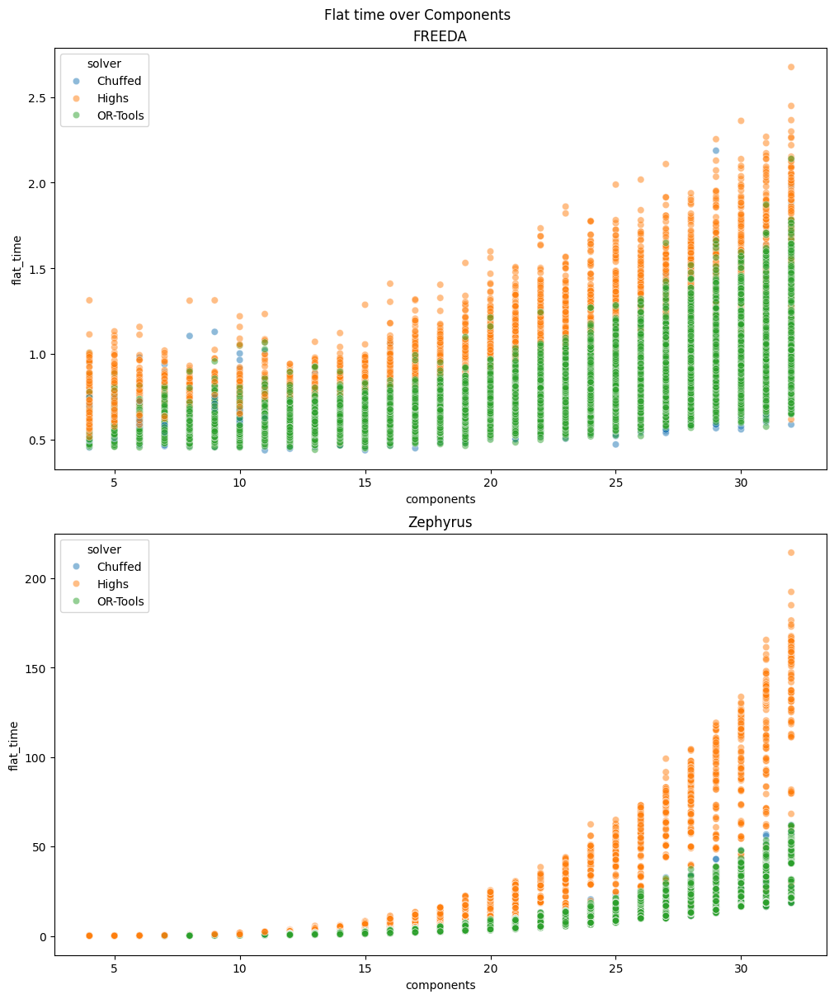

In [45]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Components")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="components",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Nodes

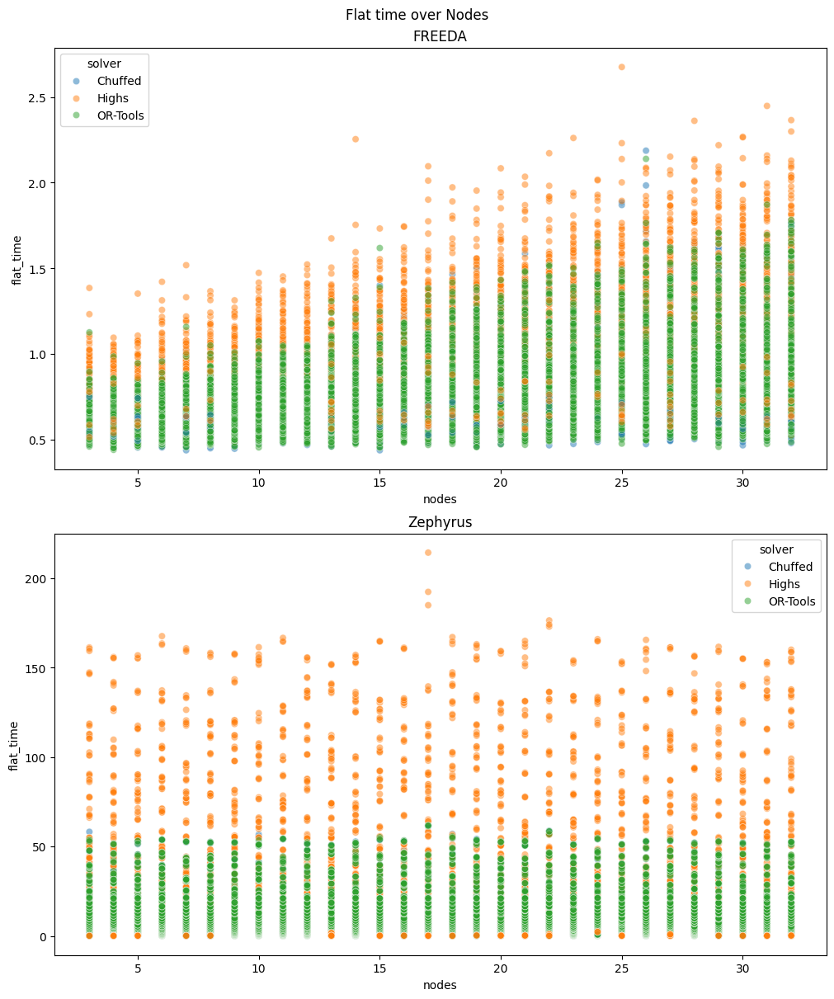

In [46]:
fig, axs = plt.subplots(len(models), 1, constrained_layout=True)
fig.suptitle("Flat time over Nodes")
fig.set_figheight(6 * len(models))
fig.set_figwidth(10)
for m, ax in zip(models, axs):
    ax.set_title(m)
    sns.scatterplot(
        data=df.query("model == @m"),
        x="nodes",
        y="flat_time",
        alpha=0.5,
        hue="solver",
        ax=ax
    )

### Components x nodes

Text(0.5, 0.98, 'Flat time for different solvers')

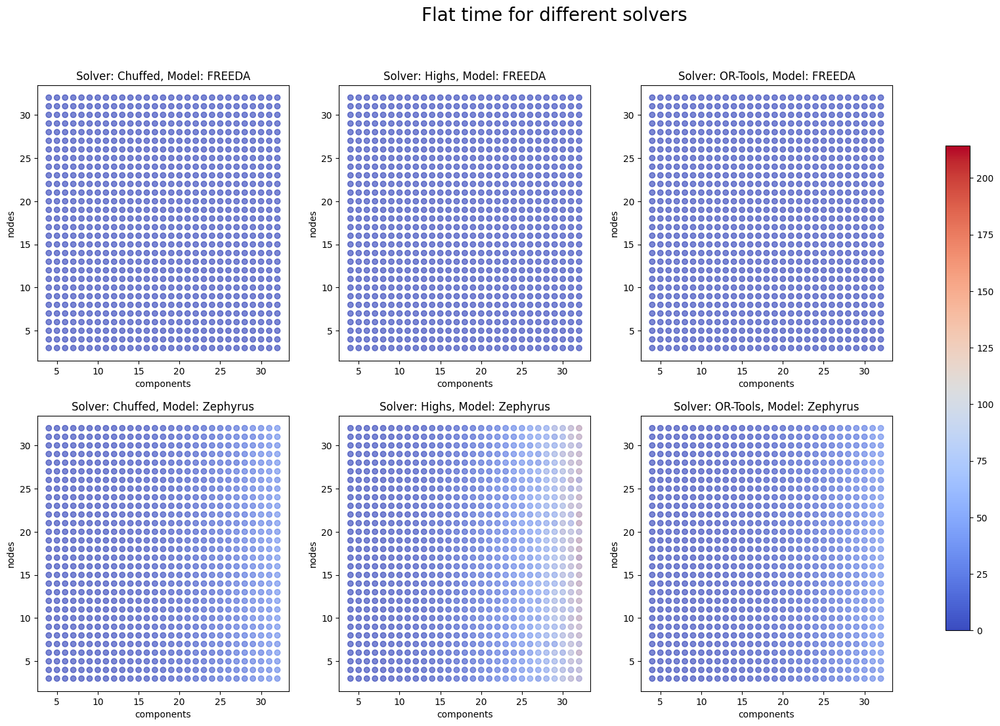

In [47]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(7 * len(solvers), 6 * len(models))
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + s + ", Model: " + m)

fig.colorbar(
    ScalarMappable(norm=norm, cmap="coolwarm"),
    ax=axs.ravel().tolist(),
    orientation='vertical',
    shrink=0.8
)
fig.suptitle("Flat time for different solvers", fontsize=20)

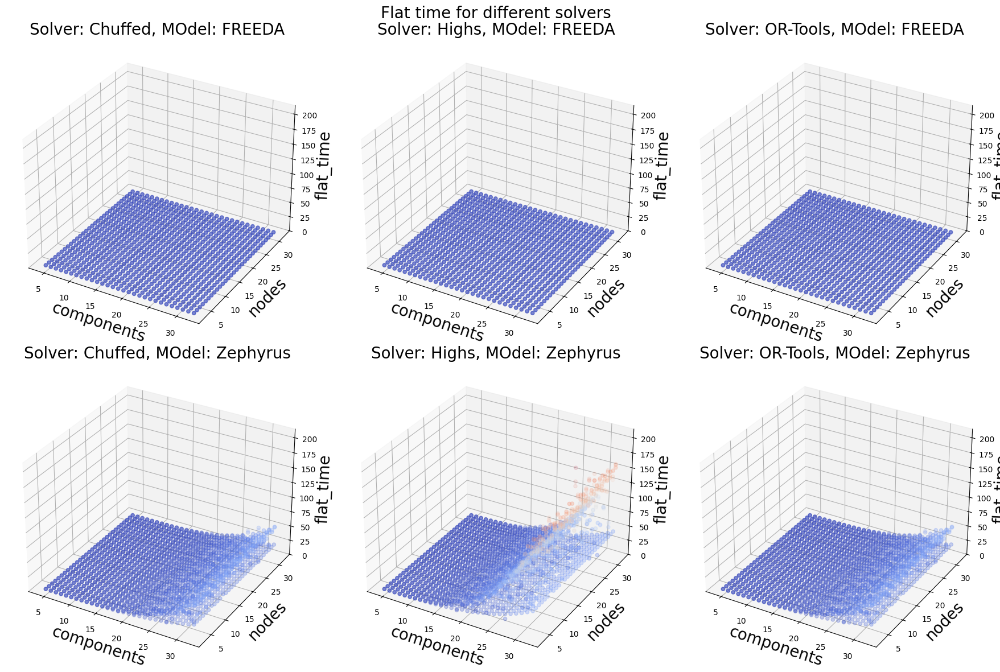

In [48]:
fig, axs = plt.subplots(
    nrows=len(models),
    ncols=len(solvers),
    figsize=(6 * len(solvers), 6 * len(models)),
    subplot_kw=dict(projection='3d')
)
norm = Normalize(vmin=0, vmax=df.flat_time.max())
for m, ax_row in zip(models, axs):
    for s, ax in zip(solvers, ax_row):
        d = df.query("model == @m").query("solver == @s")
        ax.scatter(
            xs=d.components,
            ys=d.nodes,
            zs=d.flat_time,
            c=d.flat_time,
            norm=norm,
            cmap="coolwarm",
            alpha=1.0/(len(component_topologies) * 3)
        )
        ax.set_zlim([0, df.flat_time.max()])
        ax.set_xlabel("components", fontsize=20)
        ax.set_ylabel("nodes", fontsize=20)
        ax.set_zlabel("flat_time", fontsize=20)
        ax.set_title("Solver: " + s + ", MOdel: " + m, fontsize=20)

fig.suptitle("Flat time for different solvers", fontsize=20)
fig.tight_layout()

### Topologies

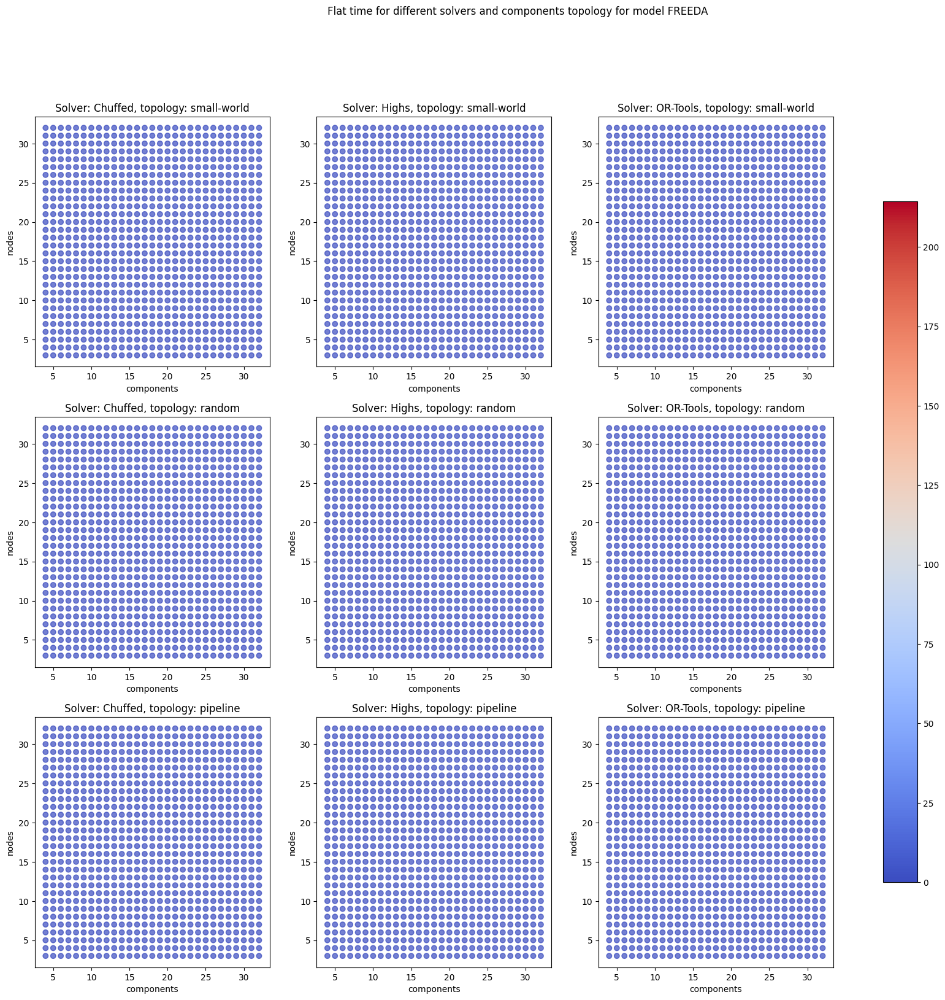

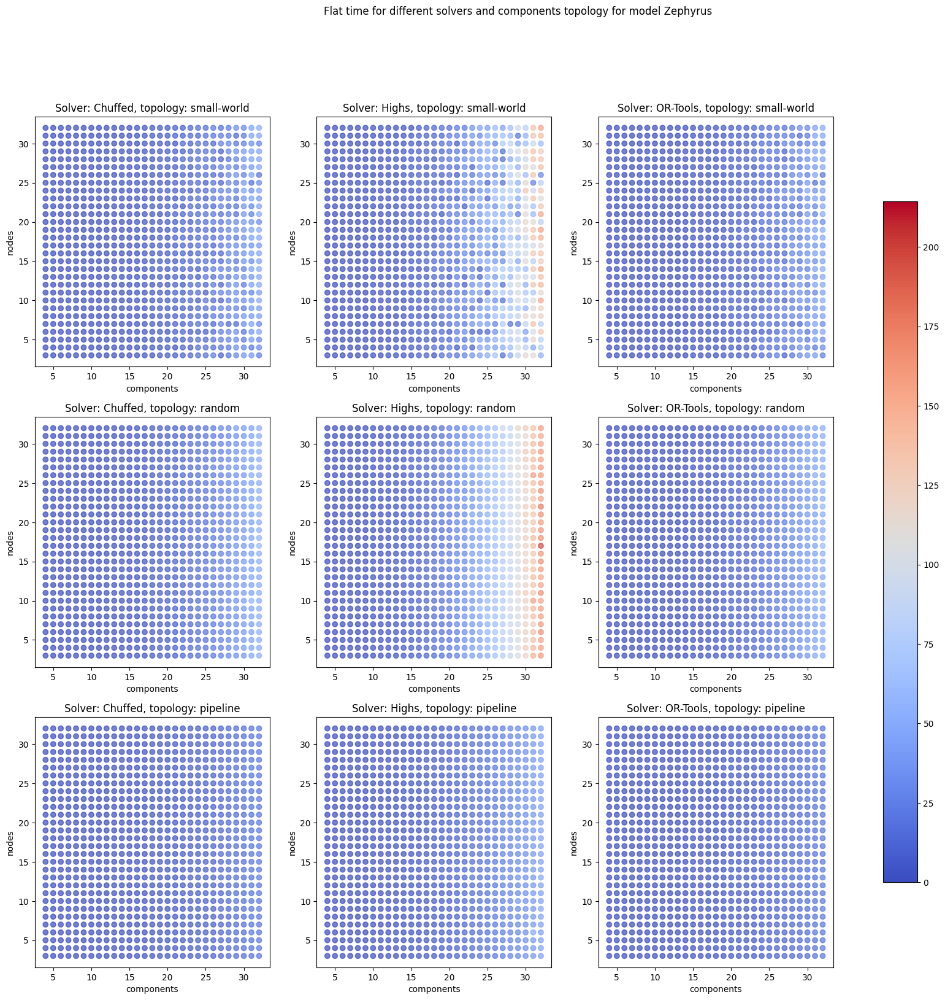

In [49]:
for m in models:
    fig, axs = plt.subplots(
        nrows=len(component_topologies),
        ncols=len(solvers),
        figsize=(7 * len(component_topologies), 6 * len(solvers))
    )
    axs_reshaped = axs.reshape(-1)
    axis = itertools.product(component_topologies, solvers)
    df_problem = df.query("model == @m")
    for (topology, solver), ax in zip(axis, axs_reshaped):
        d = df_problem.query("solver == @solver").query("comps_topology == @topology")
        ax.scatter(
            x=d.components,
            y=d.nodes,
            c=d.flat_time,
            cmap="coolwarm",
            norm=norm,
            alpha=1.0/3
        )
        ax.set_xlabel("components")
        ax.set_ylabel("nodes")
        ax.set_title("Solver: " + solver + ", topology: " + topology)

    fig.suptitle("Flat time for different solvers and components topology for model " + m)
    fig.colorbar(
        ScalarMappable(norm=norm, cmap="coolwarm"),
        ax=axs.ravel().tolist(),
        orientation='vertical',
        shrink=0.8
    )

# Flat time vs Solve time

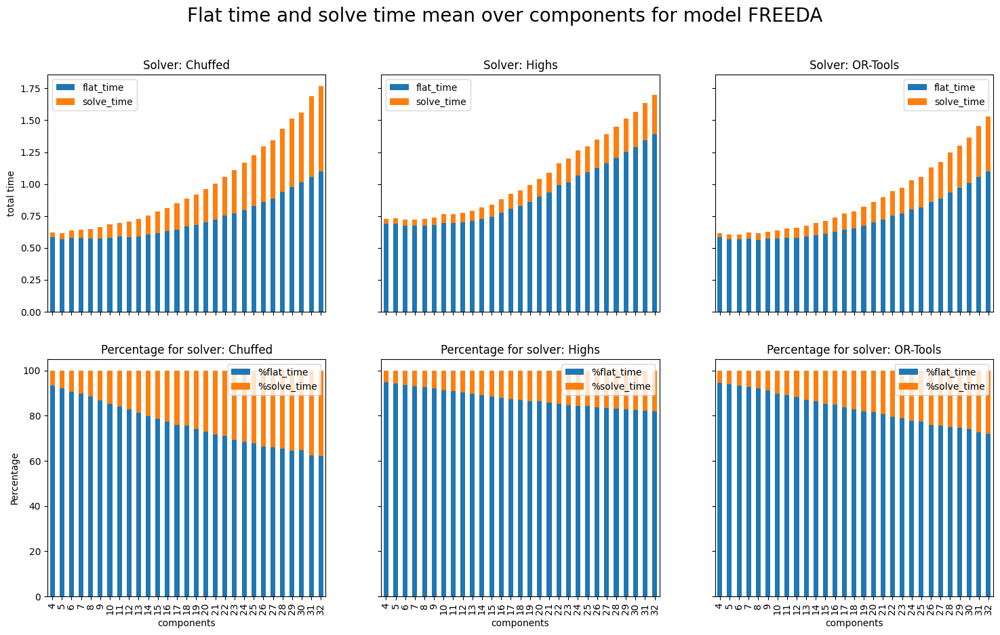

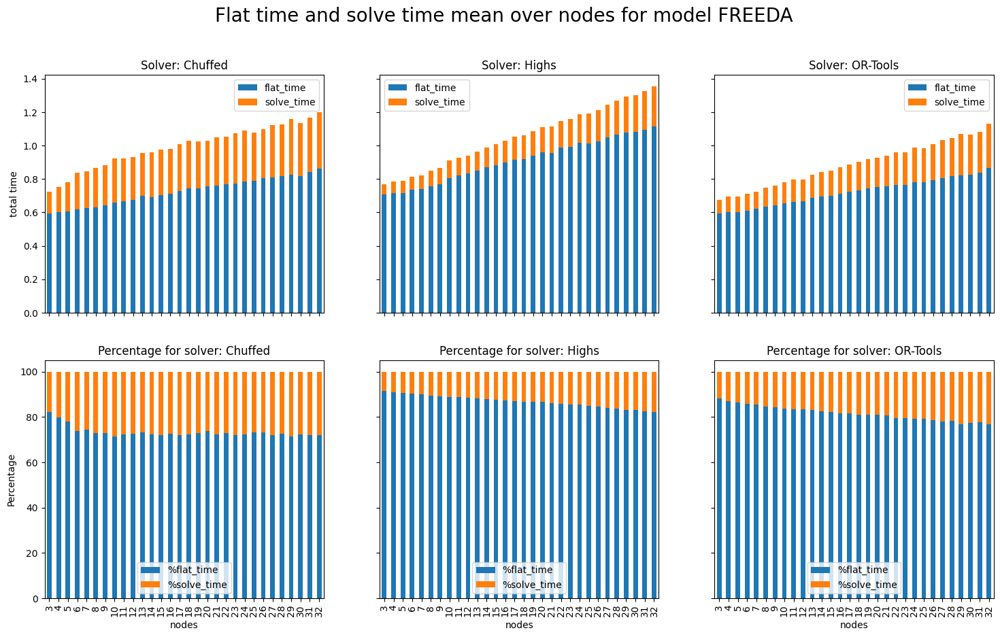

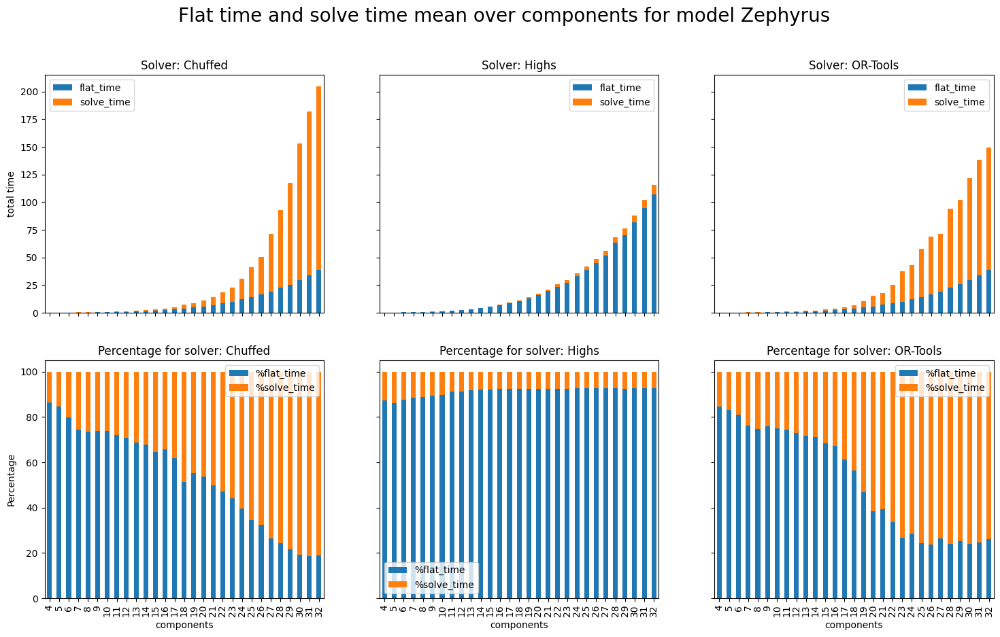

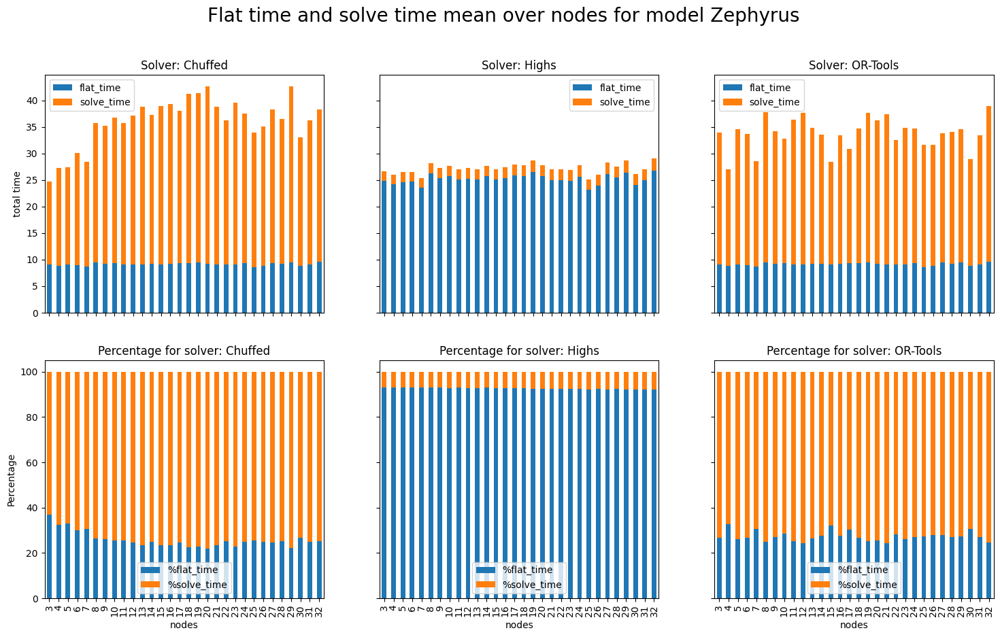

In [50]:
for m in models:
    for over in ["components", "nodes"]:
        fig, axs = plt.subplots(
            nrows=2,
            ncols=len(solvers),
            figsize=(6 * len(solvers), 10),
            sharex=True,
            sharey="row"
        )
        axs_reshaped = axs.reshape(-1)

        for solver, (i, ax) in zip(solvers, enumerate(axs_reshaped)):
            times = (
                df
                .query("solver == @solver")
                .query("model == @m")
                .assign(**{
                    "solve_time" : lambda df : df["solve_time"] - df["flat_time"]
                })
                .groupby(over)
                [["flat_time", "solve_time"]]
                .mean()
            )

            times.plot.bar(
                ax=ax,
                stacked=True,
                title="Solver: " + solver,
            )
            ax.set_ylabel("total time")

            times.assign(**{
                "%flat_time" : lambda df : (df["flat_time"] / (df["flat_time"] + df["solve_time"])) * 100,
                "%solve_time" : lambda df : (df["solve_time"] / (df["flat_time"] + df["solve_time"])) * 100
            }).drop(
                columns=["solve_time", "flat_time"]
            ).plot.bar(
                stacked=True,
                title="Percentage for solver: " + solver,
                ax=axs_reshaped[len(solvers) + i],
            )
            axs_reshaped[len(solvers) + i].set_ylabel("Percentage")

        fig.suptitle("Flat time and solve time mean over " + over + " for model " + m, fontsize=20)
        plt.show()


# Paper images and tables

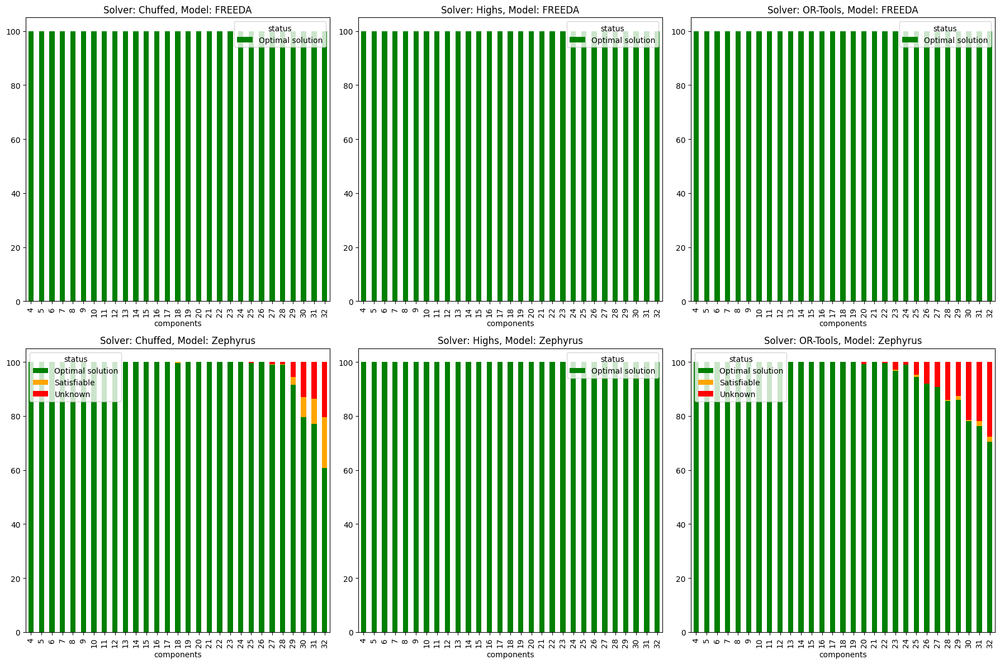

In [51]:
colors = {
    "Optimal solution": "green",
    "Unsatisfiable": "#1f77b4",
    "Unknown": "red",
    "Satisfiable" : "orange"
}
fig, axs = plt.subplots(
    nrows=2,
    ncols=len(solvers),
    figsize=(6 * len(solvers), 12)
)
norm = Normalize(vmin=0, vmax=100)
for model, ax_row in zip(models, axs):
    for solver, ax in zip(solvers, ax_row):
        d = (
            df.query("solver == @solver")
            .query("model == @model")
            [["components", "status"]]
            .groupby("components")
            .value_counts(normalize=True)
            * 100
        ).reset_index().pivot(
            index="components",
            columns="status",
            values="proportion"
        ).fillna(0)

        d.plot.bar(
            color=colors,
            stacked=True,
            ax=ax,
            title="Solver: " + solver + ", Model: " + model
        )

fig.tight_layout()
plt.show()

Text(0, 0.5, 'solve time difference')

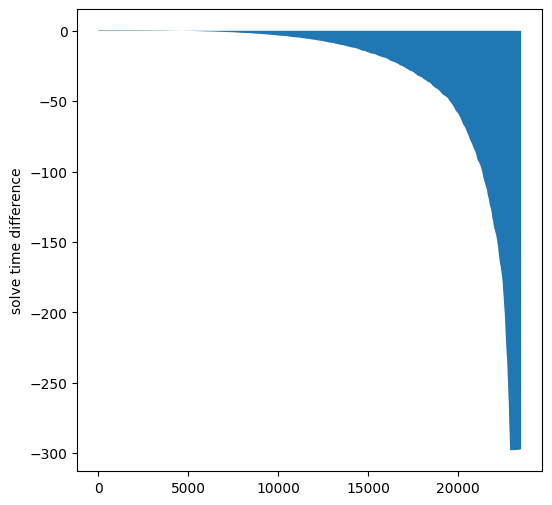

In [52]:
fig, ax = plt.subplots(1, 1, figsize=(6, 6))

area_plot = (
    df.query("model == 'FREEDA'").solve_time.sort_values().reset_index(drop=True)
    -
    df.query("model == 'Zephyrus'").solve_time.sort_values().reset_index(drop=True)
).reset_index()

ax.fill_between(area_plot.index, area_plot.solve_time)
ax.set_xlabel("")
ax.set_ylabel("solve time difference")

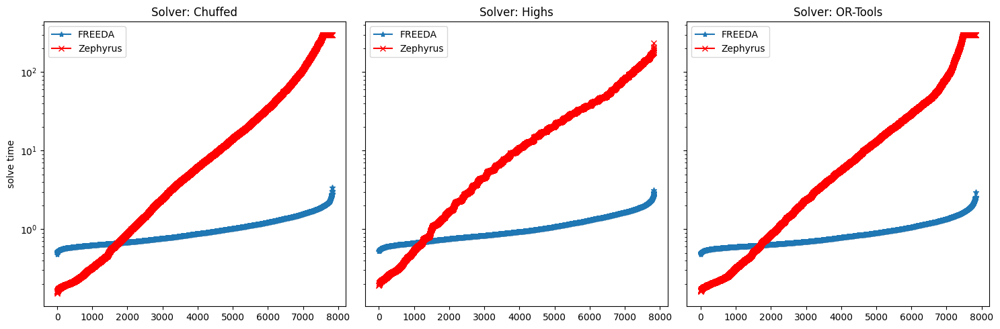

In [53]:
fig, axs = plt.subplots(
    nrows=1,
    ncols=len(solvers),
    sharex=True,
    sharey=True,
    figsize=(15, 5),
)

for solver, ax in zip(solvers, axs):
    for model in models:
        d = (
            df.query("solver == @solver")
            .query("model == @model")
            .solve_time
            .sort_values(ascending=True)
            .reset_index(drop=True)
            .reset_index()
        )
        ax.plot(
            d.index,
            d.solve_time,
            marker=marker_model[model],
            c=color_model[model],
            label=model
        )
        ax.set_title("Solver: " + solver)
        ax.set_yscale('log')
        ax.set_xlabel("")
        ax.legend()

axs[0].set_ylabel("solve time")
fig.tight_layout()

In [54]:
save_fig(fig, "solve-time-log-zeph")

In [55]:
mean_solve_time = (
    df[["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"solve_time" : "avg all"})
    .map(lambda x : str(round(x, 2)) + "s")
)
mean_solve_time

avg all
model    solver          
FREEDA   Chuffed    0.99s
         Highs      1.05s
         OR-Tools   0.89s
Zephyrus Chuffed    36.1s
         Highs     27.21s
         OR-Tools  33.77s

In [56]:
mean_opt_solve_time = (
    df
    .query("status == 'Optimal solution' or status == 'Unsatisfiable'")
    [["model", "solver", "solve_time"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"solve_time" : "avg solved"})
    .map(lambda x : str(round(x, 2)) + "s")
)
mean_opt_solve_time

avg solved
model    solver             
FREEDA   Chuffed       0.99s
         Highs         1.05s
         OR-Tools      0.89s
Zephyrus Chuffed      27.25s
         Highs        27.21s
         OR-Tools     21.05s

In [57]:
perc = (
    df[["model", "solver", "status"]]
    .groupby(["model", "solver"])
    .aggregate(lambda x : str(round((
        len(x[x.str.contains("Optimal solution") | x.str.contains("Unsatisfiable")]) / len(x)) * 100,
        2)) + "%")
    .rename(columns={"status" : "solved"})
)
perc

complete
model    solver           
FREEDA   Chuffed    100.0%
         Highs      100.0%
         OR-Tools   100.0%
Zephyrus Chuffed    96.76%
         Highs      100.0%
         OR-Tools   95.44%

In [58]:
# Istances where solvers are bugged
df_model_solver = df.assign(**{
    "model_solver": lambda df : df.apply(lambda x : x.model + "_" + x.solver, axis=1)
}).drop(columns=["flavours", "resources", "flat_time", "infra_topology"])

models_solvers = itertools.combinations([m + "_" + s for m, s in itertools.product(models, solvers)], r=2)

scores = []
for model_solver1, model_solver2 in models_solvers:
    to_group = df_model_solver.query("model_solver == @model_solver1 or model_solver == @model_solver2")
    for _, group in to_group.groupby(["components", "nodes", "comps_topology", "test"]):
        scores.append(group.assign(score=borda_count))

In [59]:
scores_df = (
    pd.concat(scores)
    [["model", "solver", "score"]]
    .groupby(["model", "solver"])
    .sum()
    .map(lambda x : round(x, 2))
)
scores_df

score
model    solver            
FREEDA   Chuffed   27816.77
         Highs     27079.27
         OR-Tools  29263.86
Zephyrus Chuffed   11889.73
         Highs      9043.55
         OR-Tools  12356.83

In [60]:
min_max = (
    df[["model", "solve_time", "solver"]]
    .groupby(["model", "solver"])
    .aggregate(["min", "max"])
    .map(lambda x : str(round(x, 2)) + "s")
)
min_max.columns = min_max.columns.droplevel()
min_max

min      max
model    solver                  
FREEDA   Chuffed   0.48s    3.43s
         Highs     0.53s    3.15s
         OR-Tools  0.48s    2.96s
Zephyrus Chuffed   0.15s   300.0s
         Highs     0.19s  232.86s
         OR-Tools  0.16s   300.0s

In [61]:
flat = (
    df[["model", "flat_time", "solver"]]
    .groupby(["model", "solver"])
    .aggregate("mean")
    .rename(columns={"flat_time" : "flat"})
    #.unstack()
    .map(lambda x : str(round(x, 2)) + "s")
)
flat

flat
model    solver          
FREEDA   Chuffed    0.73s
         Highs      0.91s
         OR-Tools   0.72s
Zephyrus Chuffed    9.15s
         Highs     25.19s
         OR-Tools   9.16s

In [62]:
first_last = (
    df
    .query("status == 'Optimal solution' or status == 'Satisfiable'")
    [["model", "objectives", "solver"]]
    .assign(**{
        "first" : lambda df : df.objectives.apply(lambda d : min(float(t) for t in d.keys())),
        "last" : lambda df : df.objectives.apply(lambda d : max(float(t) for t in d.keys()))
    }).drop(columns=["objectives"])
    .groupby(["model", "solver"])
    .aggregate("mean")
    .map(lambda x : str(round(x, 2)) + "s")
)
first_last

first    last
model    solver                  
FREEDA   Chuffed    0.84s   0.99s
         Highs      1.02s   1.02s
         OR-Tools   0.81s   0.86s
Zephyrus Chuffed   22.69s  30.78s
         Highs     26.89s  27.09s
         OR-Tools  19.43s   21.4s

In [63]:
print(
    pd.concat([
        perc,
        mean_solve_time,
        mean_opt_solve_time,
        min_max,
        first_last,
        flat,
        scores_df,
    ], axis=1)
    .sort_values("score", ascending=False)
    #.reset_index()
    .to_latex(multicolumn=False, escape=True, multirow=False, float_format="%.2f")
)

\begin{tabular}{llllllllllr}
\toprule
 &  & complete & avg all & avg solved & min & max & first & last & flat & score \\
model & solver &  &  &  &  &  &  &  &  &  \\
\midrule
FREEDA & OR-Tools & 100.0\% & 0.89s & 0.89s & 0.48s & 2.96s & 0.81s & 0.86s & 0.72s & 29263.86 \\
 & Chuffed & 100.0\% & 0.99s & 0.99s & 0.48s & 3.43s & 0.84s & 0.99s & 0.73s & 27816.77 \\
 & Highs & 100.0\% & 1.05s & 1.05s & 0.53s & 3.15s & 1.02s & 1.02s & 0.91s & 27079.27 \\
Zephyrus & OR-Tools & 95.44\% & 33.77s & 21.05s & 0.16s & 300.0s & 19.43s & 21.4s & 9.16s & 12356.83 \\
 & Chuffed & 96.76\% & 36.1s & 27.25s & 0.15s & 300.0s & 22.69s & 30.78s & 9.15s & 11889.73 \\
 & Highs & 100.0\% & 27.21s & 27.21s & 0.19s & 232.86s & 26.89s & 27.09s & 25.19s & 9043.55 \\
\bottomrule
\end{tabular}

